In [86]:
import geopandas as gpd
import pandas as pd
from shapely.geometry import Point
%matplotlib inline
import seaborn as sns
pd.set_option('display.max_columns', None)
import matplotlib.pyplot as plt
import numpy as np
import matplotlib.colors

In [147]:
sidewalk_labels = pd.read_csv("SeattleData/SeattleNormalizedSidewalkLabelCounts.csv")

In [131]:
social_factors = pd.read_csv("SeattleData/SeattleSocialFactors.csv")

In [148]:
social_factors = social_factors.rename(columns={'Geo_FIPS': 'GEOID10'})
social_factors.head()

,GEOID10,ttw_30_59%,ttw_60_89%,ttw_90%,ttw_bycar%,ttw_bytransit%,ttw_bybike%,ttw_byfoot%,median_rent,income_household_median,income_percapita,quality_of_life_score,transport_expenditure%,ppl_density
0,530330001001,0.248281,0.000000,0.000000,0.365887,0.070839,0.026823,0.000000,1647,154138,71251,133,0.149076,4209.9
1,530330001002,0.183011,0.015884,0.060083,0.306630,0.185773,0.000000,0.000000,821,30978,23190,123,0.157356,13004.2
2,530330001003,0.314521,0.022194,0.000000,0.424857,0.103995,0.019023,0.000000,797,66118,52181,119,0.152064,11017.0
3,530330001004,0.124636,0.056494,0.000000,0.367501,0.147932,0.000000,0.012813,674,34758,22211,124,0.158326,35176.5
4,530330001005,0.253406,0.023615,0.000000,0.345141,0.184378,0.015441,0.020890,989,57292,41977,119,0.152415,12370.6


In [149]:
df = social_factors.merge(sidewalk_labels, how='outer', on='GEOID10').fillna(0)

In [150]:
df

,GEOID10,ttw_30_59%,ttw_60_89%,ttw_90%,ttw_bycar%,ttw_bytransit%,ttw_bybike%,ttw_byfoot%,median_rent,income_household_median,income_percapita,quality_of_life_score,transport_expenditure%,ppl_density,labels_all_count,labels_s5_count,labels_s4_count,labels_s3_count,labels_s2_count,labels_s1_count,street_length,labels_all_per_ft,labels_s1_per_ft,labels_s2_per_ft,labels_s3_per_ft,labels_s4_per_ft,labels_s5_per_ft
0,530330001001,0.248281,0.000000,0.000000,0.365887,0.070839,0.026823,0.000000,1647,154138,71251,133,0.149076,4209.9,0.0,0.0,0.0,0.0,0.0,0.0,18360.647342,0.0,0.0,0.0,0.0,0.0,0.0
1,530330001002,0.183011,0.015884,0.060083,0.306630,0.185773,0.000000,0.000000,821,30978,23190,123,0.157356,13004.2,0.0,0.0,0.0,0.0,0.0,0.0,6352.000000,0.0,0.0,0.0,0.0,0.0,0.0
2,530330001003,0.314521,0.022194,0.000000,0.424857,0.103995,0.019023,0.000000,797,66118,52181,119,0.152064,11017.0,0.0,0.0,0.0,0.0,0.0,0.0,4150.000000,0.0,0.0,0.0,0.0,0.0,0.0
3,530330001004,0.124636,0.056494,0.000000,0.367501,0.147932,0.000000,0.012813,674,34758,22211,124,0.158326,35176.5,0.0,0.0,0.0,0.0,0.0,0.0,1334.000000,0.0,0.0,0.0,0.0,0.0,0.0
4,530330001005,0.253406,0.023615,0.000000,0.345141,0.184378,0.015441,0.020890,989,57292,41977,119,0.152415,12370.6,0.0,0.0,0.0,0.0,0.0,0.0,4796.000000,0.0,0.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
474,530330120003,0.283931,0.051482,0.012480,0.469579,0.075663,0.000000,0.000000,1439,110577,60986,130,0.154575,7024.4,0.0,0.0,0.0,0.0,0.0,0.0,14930.000000,0.0,0.0,0.0,0.0,0.0,0.0
475,530330121001,0.115385,0.042986,0.007541,0.388386,0.022624,0.000000,0.000000,1500,139338,82249,132,0.151154,4045.7,0.0,0.0,0.0,0.0,0.0,0.0,14383.000000,0.0,0.0,0.0,0.0,0.0,0.0
476,530330121002,0.156708,0.015220,0.008455,0.407554,0.026494,0.000000,0.000000,1415,117602,59913,135,0.153299,5266.6,0.0,0.0,0.0,0.0,0.0,0.0,21226.000000,0.0,0.0,0.0,0.0,0.0,0.0
477,530330263001,0.086498,0.016878,0.000000,0.405063,0.021097,0.000000,0.000000,893,82576,38556,123,0.154384,395.8,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0


In [151]:
df_plot=df.drop(columns=['GEOID10','labels_s1_count', 'labels_s2_count','labels_s3_count','labels_s4_count','labels_s5_count'])

In [129]:
norm = matplotlib.colors.Normalize(-1,1)
colors = [[norm(-1.0), "#00b1b3"],
          [norm(-0.6), "#78c7c7"],
          [norm(-0.3), "#b7dcdc"],
          [norm(0), "#f1f1f1"],
          [norm( 0.3), "#fbccb2"],
          [norm( 0.6), "#fca776"],
          [norm( 1.0), "#f58238"]]

cmap = matplotlib.colors.LinearSegmentedColormap.from_list("", colors)

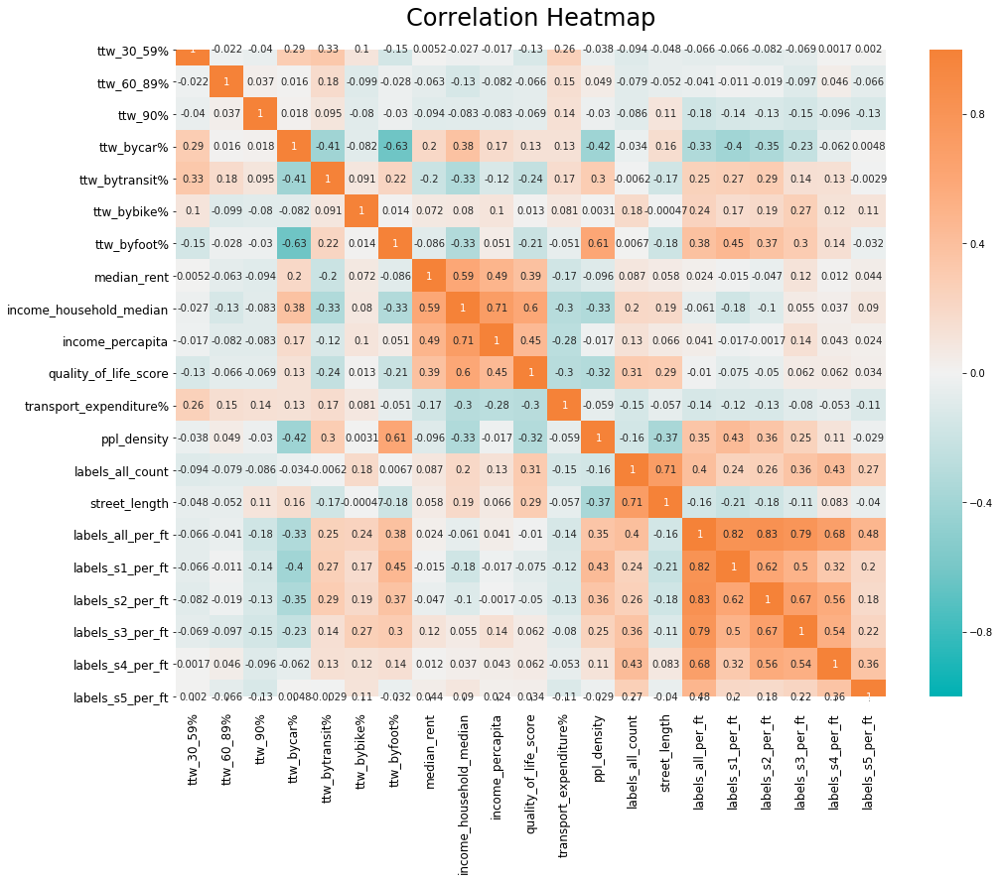

In [153]:
fig, axs = plt.subplots(figsize=(16,12))
heatmap = sns.heatmap(df_plot.corr(), vmin=-1, vmax=1, annot=True, cmap=cmap)
heatmap.set_title('Correlation Heatmap', fontdict={'fontsize':24}, pad=24);
axs.tick_params(axis='y', labelsize=12)
axs.tick_params(axis='x', labelsize=12, pad=12)

In [209]:
fig.savefig("out.png")

### Conclusion
Within a census block group, labels count per foot has positive correlations with percentage of people who travel to work by transit by bike, by foot; has a negative correation with percentage of people who travel to work by car.

It suggests that neighbourhoods with better quality sidewalk have more people travel to work by walking, bike, public transit and fewer people travel to work by car.

In [ ]:
#map travel to work by car on interactive map

In [183]:
bycar= social_factors[['GEOID10','ttw_bycar%']]

In [184]:
bycar

,GEOID10,ttw_bycar%
0,530330001001,0.365887
1,530330001002,0.306630
2,530330001003,0.424857
3,530330001004,0.367501
4,530330001005,0.345141
...,...,...
474,530330120003,0.469579
475,530330121001,0.388386
476,530330121002,0.407554
477,530330263001,0.405063


In [185]:
bg = gpd.read_file('SeattleData/Census_Block_Groups_2010/Census_Block_Groups_2010.shp')
bg.head()

,OBJECTID,TRACTCE10,BLKGRPCE10,GEOID10,NAMELSAD10,INTPTLAT10,INTPTLON10,TRACT,TRBG,TRBG_STR,ACRES_TOTA,ACRES_LAND,ACRES_WATE,WATER,SHAPE_Leng,SHAPE_Area,geometry
0,1,000100,1,530330001001,Block Group 1,+47.7276870,-122.2815160,100,100.1,100.1,588.283002,221.041200,367.285577,NaN,21168.918543,2.562561e+07,"POLYGON ((-122.26840 47.72641, -122.26719 47.7..."
1,2,000100,2,530330001002,Block Group 2,+47.7293165,-122.2924690,100,100.2,100.2,71.258030,71.263215,0.000000,NaN,8692.089186,3.104000e+06,"POLYGON ((-122.28970 47.73193, -122.28965 47.7..."
2,3,000100,3,530330001003,Block Group 3,+47.7228093,-122.2894558,100,100.3,100.3,91.604629,91.611355,0.000000,NaN,8560.645769,3.990298e+06,"POLYGON ((-122.28633 47.72093, -122.28629 47.7..."
3,4,000100,4,530330001004,Block Group 4,+47.7319367,-122.2944531,100,100.4,100.4,31.237245,31.239309,0.000000,NaN,4693.439609,1.360694e+06,"POLYGON ((-122.29237 47.73194, -122.29231 47.7..."
4,5,000100,5,530330001005,Block Group 5,+47.7229283,-122.2944374,100,100.5,100.5,56.956546,56.960756,0.000000,NaN,7450.759251,2.481027e+06,"POLYGON ((-122.29273 47.72019, -122.29273 47.7..."


In [186]:
bg_geo = bg[['GEOID10','geometry']]

In [187]:
bg_geo

,GEOID10,geometry
0,530330001001,"POLYGON ((-122.26840 47.72641, -122.26719 47.7..."
1,530330001002,"POLYGON ((-122.28970 47.73193, -122.28965 47.7..."
2,530330001003,"POLYGON ((-122.28633 47.72093, -122.28629 47.7..."
3,530330001004,"POLYGON ((-122.29237 47.73194, -122.29231 47.7..."
4,530330001005,"POLYGON ((-122.29273 47.72019, -122.29273 47.7..."
...,...,...
477,530330117003,"POLYGON ((-122.28084 47.52520, -122.28082 47.5..."
478,530330117004,"POLYGON ((-122.27932 47.52258, -122.27954 47.5..."
479,530330118001,"POLYGON ((-122.26232 47.53173, -122.24933 47.5..."
480,530330118002,"POLYGON ((-122.25464 47.51692, -122.25455 47.5..."


In [188]:
bg_geo=bg_geo.astype({'GEOID10': 'int64'})

In [189]:
bycar_geo = bycar.merge(bg_geo, how='inner', on='GEOID10')

In [190]:
bycar_geo = gpd.GeoDataFrame(bycar_geo, geometry='geometry')

In [191]:
bycar_geo

,GEOID10,ttw_bycar%,geometry
0,530330001001,0.365887,"POLYGON ((-122.26840 47.72641, -122.26719 47.7..."
1,530330001002,0.306630,"POLYGON ((-122.28970 47.73193, -122.28965 47.7..."
2,530330001003,0.424857,"POLYGON ((-122.28633 47.72093, -122.28629 47.7..."
3,530330001004,0.367501,"POLYGON ((-122.29237 47.73194, -122.29231 47.7..."
4,530330001005,0.345141,"POLYGON ((-122.29273 47.72019, -122.29273 47.7..."
...,...,...,...
472,530330120001,0.467717,"POLYGON ((-122.37115 47.51446, -122.37110 47.5..."
473,530330120002,0.514663,"POLYGON ((-122.37502 47.51185, -122.37477 47.5..."
474,530330120003,0.469579,"POLYGON ((-122.38929 47.51751, -122.38928 47.5..."
475,530330121001,0.388386,"POLYGON ((-122.39433 47.51971, -122.39415 47.5..."


In [206]:
bycar_map = bycar_geo.explore(tiles="CartoDB positron",
                  column="ttw_bycar%",
                  scheme="naturalbreaks",
                  style_kwds=dict(stroke=False),
                tooltip="ttw_bycar%"
                 )

In [200]:
labels_geo = gpd.read_file('SeattleData/LabelsGeo.shp')
labels_geo.head()

,Attribute,Label Type,Street ID,OSM Street,Neighborho,latitude,longtitude,Severity,Temporary,Agree Coun,Disagree C,Not Sure C,geometry
0,57259626,CurbRamp,22481,394459713,Portage Bay,47.643120,-122.32030,3.0,0,0,0,1,POINT (-122.32030 47.64312)
1,57259627,CurbRamp,12051,13521798,Portage Bay,47.643257,-122.32189,1.0,0,2,0,0,POINT (-122.32189 47.64326)
2,57259629,CurbRamp,12051,13521798,Portage Bay,47.643116,-122.32210,1.0,0,2,1,0,POINT (-122.32210 47.64312)
3,57259630,CurbRamp,22481,394459713,Portage Bay,47.643154,-122.32017,1.0,0,1,0,0,POINT (-122.32017 47.64315)
4,57259632,CurbRamp,6732,6456858,Portage Bay,47.651380,-122.32120,1.0,0,2,0,0,POINT (-122.32120 47.65138)


In [201]:
labels_s1_geo =labels_geo.loc[labels_geo['Severity'] == 1.0]

In [202]:
labels_s1_geo

,Attribute,Label Type,Street ID,OSM Street,Neighborho,latitude,longtitude,Severity,Temporary,Agree Coun,Disagree C,Not Sure C,geometry
1,57259627,CurbRamp,12051,13521798,Portage Bay,47.643257,-122.321890,1.0,0,2,0,0,POINT (-122.32189 47.64326)
2,57259629,CurbRamp,12051,13521798,Portage Bay,47.643116,-122.322100,1.0,0,2,1,0,POINT (-122.32210 47.64312)
3,57259630,CurbRamp,22481,394459713,Portage Bay,47.643154,-122.320170,1.0,0,1,0,0,POINT (-122.32017 47.64315)
4,57259632,CurbRamp,6732,6456858,Portage Bay,47.651380,-122.321200,1.0,0,2,0,0,POINT (-122.32120 47.65138)
6,57259634,CurbRamp,22366,392696872,Portage Bay,47.650010,-122.322180,1.0,0,0,0,0,POINT (-122.32218 47.65001)
...,...,...,...,...,...,...,...,...,...,...,...,...,...
93756,59103770,Crosswalk,26445,537714301,Greenwood,47.686874,-122.360660,1.0,0,3,1,0,POINT (-122.36066 47.68687)
93758,59103773,Crosswalk,25421,465991369,Greenwood,47.690610,-122.356500,1.0,0,4,0,0,POINT (-122.35650 47.69061)
93759,59103776,Crosswalk,25422,465991369,Greenwood,47.690613,-122.356804,1.0,0,4,0,0,POINT (-122.35680 47.69061)
93760,59103777,Crosswalk,5047,6428527,Greenwood,47.686222,-122.357050,1.0,0,4,0,0,POINT (-122.35705 47.68622)


In [208]:
labels_s1_geo.explore(
m=bycar_map,
color= '#F57E25',
marker_kwds=dict(raidus=0.1, fill=True),
style_kwds=dict(opacity=0.2),
tooltip = 'Label Type'
)

In [211]:
bycar_geo

,GEOID10,ttw_bycar%,geometry
0,530330001001,0.365887,"POLYGON ((-122.26840 47.72641, -122.26719 47.7..."
1,530330001002,0.306630,"POLYGON ((-122.28970 47.73193, -122.28965 47.7..."
2,530330001003,0.424857,"POLYGON ((-122.28633 47.72093, -122.28629 47.7..."
3,530330001004,0.367501,"POLYGON ((-122.29237 47.73194, -122.29231 47.7..."
4,530330001005,0.345141,"POLYGON ((-122.29273 47.72019, -122.29273 47.7..."
...,...,...,...
472,530330120001,0.467717,"POLYGON ((-122.37115 47.51446, -122.37110 47.5..."
473,530330120002,0.514663,"POLYGON ((-122.37502 47.51185, -122.37477 47.5..."
474,530330120003,0.469579,"POLYGON ((-122.38929 47.51751, -122.38928 47.5..."
475,530330121001,0.388386,"POLYGON ((-122.39433 47.51971, -122.39415 47.5..."


In [212]:
bycar_geo.explore(tiles="CartoDB positron",
                  column="ttw_bycar%",
                  scheme="naturalbreaks",
                  style_kwds=dict(stroke=False),
                tooltip="ttw_bycar%"
                 )